## Introducción a la Visión Computacional
## Tarea 1
-----------------------
<div align="right">
Fecha de Entrega: Miércoles 5, Abril 2022.
</div>

1. Buscar una base de datos (dataset) de imágenes abierta. Por ejemplo, de Kaggle (https://www.kaggle.com/datasets?tags=13207-Computer+Vision). Si dispone de una base de datos propia (o tiene acceso a alguna no pública), también  puede ser utilizada. Hacer una breve descripción de esta base de datos: número de fotos, sensor con el cual fue obtenido, condiciones ambientales, tipos de elementos que aparecen (automóviles, animales, insectos, caras, entre otros)

2. Buscar una aplicación interesante para ese conjunto de imágenes. Se debe justificar en un párrafo el por qué es una aplicación que valga la pena implementar o realizar. La aplicación requeriría detectar o medir algo y en forma automatizada dentro de cada imagen.

3. Hacer pre-procesamiento simple:
    + Implementar un código que realice en forma masiva un cambio de resolución de las imágenes (por ejemplo unas 100 a una resolución menor, por ejemplo, 256x256 o 512x512). Para ello, las imágenes fuente deben estar en un directorio y las de salida en uno diferente.
    + Implementar un código que filtre (por ejemplo, gaussiano) las imágenes y las deje en un nuevo directorio.


Debe documentar en un breve informe lo realizado: puede ser en formato pdf, o bien en un notebook.

Más importante que mostrar la totalidad de lo procesado, es mostrar solamente algunos casos que sean ilustrativos, junto con algunos específicos que se no se ajusten al común o promedio de los resultados. Tan importante como mostrar estos resultados mencionados, son los comentarios de la particularidad que tienen los casos a reportar.

*************

# Tarea 1
Nombre: Patricio Soto <br/>
Asignatura: Vision Computacional

Se elige un set de imagenes de Fuego y Humo, estas imagenes provienen desde distintos dispositivos como camaras y  celulares de distintas marcas, tomadas por distintas personas. El objetivo es ver si es posible identificar el fuego para poder desarrollar algun algoritmo que sirva en la identificacion de inicio o riesgos de incendios con camaras de seguridad.

Link: https://www.kaggle.com/datasets/dataclusterlabs/fire-and-smoke-dataset


In [1]:
import glob
from pathlib import Path
from PIL import Image, ImageFilter

In [153]:
_RESIZE_PERCENT = 0.3
_THRESHOLD = 200
_INPUT_FOLDER = 'input_img'
_OUTPUT_FOLDER = 'output_img'
_TYPES_IMG = ('*.jpg', '*.png')

In [132]:

img_metadata_files = []

def read_all_imgs():
    print('\n Leyendo archivos de Imagen y convirtiendo a objeto.')
    img_list = []
    for ext in _TYPES_IMG:
        img_list.extend(glob.glob(_INPUT_FOLDER+'\\'+ext))
    for file in img_list:
        img_path = Path(file)
        img = Image.open(file)
        img_metadata = { 
                        'name': img_path.name, 
                        'ext': img_path.suffix, 
                        'path': file, 
                        'img': img,
                        'img_processed':None,
                        'size_file': img_path.stat().st_size, 
                        'size_img': img.size
                       }
        img_metadata_files.append(type('img_metadata', (object,),img_metadata)() )
        print('. ', end='')

def save_processed_imgs(output_folder):
    fullpath_output = _OUTPUT_FOLDER+'\\'+output_folder
    print('\n Guardando imagenes procesadas en {0}.'.format(fullpath_output))
    for img_metadata in img_metadata_files:
        img_metadata.img_processed.save(fullpath_output+r'\{0}'.format(img_metadata.name))
        print('. ', end='')
        
def resize_all_imgs():
    print('\n Procesando Imagenes ... Cambiando Tamaño ...')
    for img_metadata in img_metadata_files:
        x = img_metadata.size_img[0] * _RESIZE_PERCENT
        y = img_metadata.size_img[1] * _RESIZE_PERCENT
        img_metadata.img_processed = img_metadata.img.resize((int(round(x,0)),int(round(y,0))))
        print('. ', end='')

def identify_fire_all_imgs():
    print('\n Procesando Imagenes ... Filtrado e Identificacion del Fuego ...')
    for img_metadata in img_metadata_files:
        img_processed = img_metadata.img.convert('L')
        img_processed = img_processed.filter(ImageFilter.GaussianBlur(5))
        img_processed = img_processed.point(lambda pxl: 255 if pxl > _THRESHOLD else 0)
        img_processed = img_processed.convert('1')
        img_metadata.img_processed = img_processed
        print('. ', end='')


In [154]:
read_all_imgs()
resize_all_imgs()
save_processed_imgs('resized')
identify_fire_all_imgs()
save_processed_imgs('filtered')


 Leyendo archivos de Imagen y convirtiendo a objeto.
. . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . 
 Procesando Imagenes ... Cambiando Tamaño ...
. . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . 
 Guardando imagenes procesadas en output_img\resized.
. . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . 

**********

******************

En la primera parte se prefirió disminuir el tamaño en pixeles de forma porcentual, al darse cuenta que los tamaños no eran simétricos en las imágenes lo que daría como resultado la deformación de las mismas.

In [217]:
for i in [10, 30, 45, 90]:
    print('Imagen {0} tamaño:'.format(i), img_metadata_files[i].img.size)

Imagen 10 tamaño: (1920, 4160)
Imagen 30 tamaño: (2576, 1932)
Imagen 45 tamaño: (4000, 1844)
Imagen 90 tamaño: (352, 640)


Ejemplo, en imagen 10 tiene un tamaño de 1920x4160 y la imagen 30 tiene un tamaño de 2576x1932. Estas se redujeron a un 30% de su tamaño. Quedando en 576x1248 y 773x580 respectivamente.

In [220]:
for i in [10, 30, 45, 90]:
    print('Imagen {0} tamaño cambiado: '.format(i), 
          Image.open('.\\output_img\\resized\\'+img_metadata_files[i].name).size)

Imagen 10 tamaño cambiado:  (576, 1248)
Imagen 30 tamaño cambiado:  (773, 580)
Imagen 45 tamaño cambiado:  (1200, 553)
Imagen 90 tamaño cambiado:  (106, 192)


*********

*************

En la segunda parte se intenta realizar operaciones y filtrado para ver la posibilidad de identificar solo las llamas de las imágenes.
Tomaremos el ejemplo de la imagen 45 como exitoso.

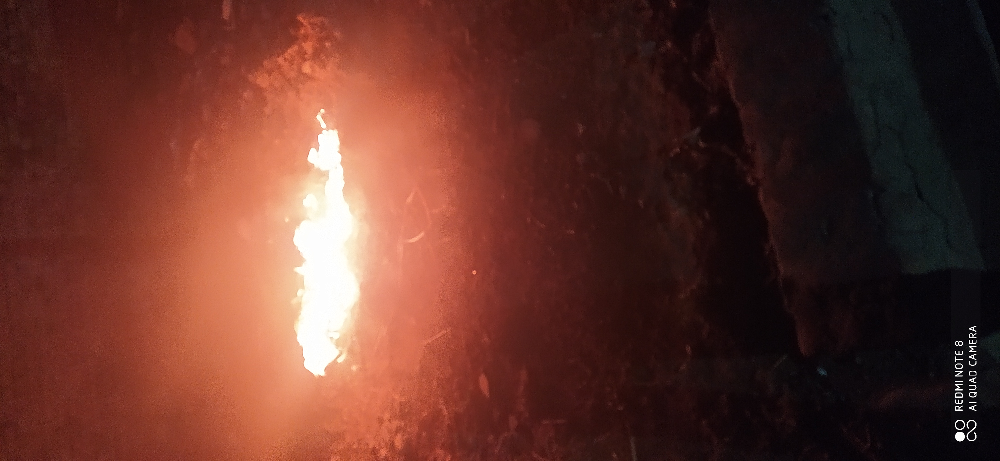

In [208]:
img_metadata_files[45].img

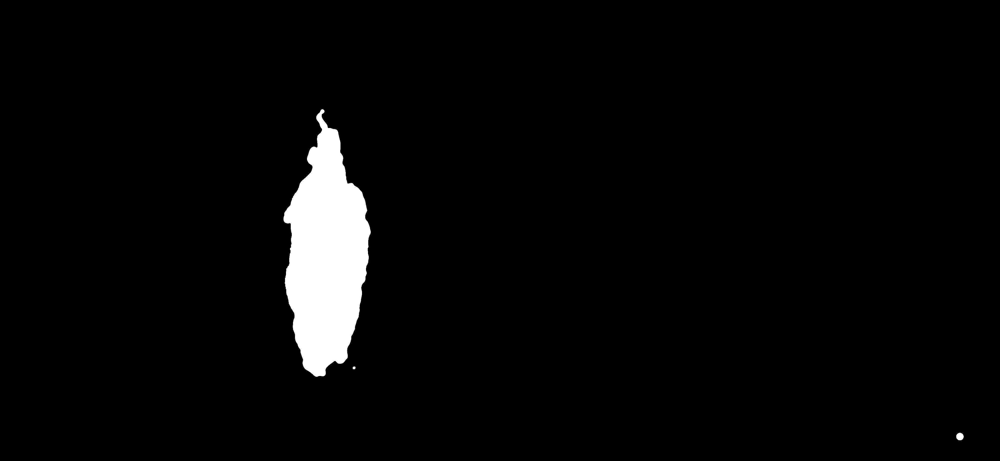

In [199]:
Image.open('.\\output_img\\filtered\\'+img_metadata_files[45].name)

Para llegar a este resultado lo primero que realizamos es convertir la imagen a blanco y negro, para luego realizar un filtro de desenfoque gaussiano para suavizar la imagen y luego se recorrieron los pixeles y se mantuvieron solo los pixeles con una luminosidad mayor a 200. Al finalizar se vuelve a convertir a 1-bit por pixel para eliminar lo suavizado.

Mostraremos otros ejemplo de éxito antes de seguir conversado de los inconvenientes.

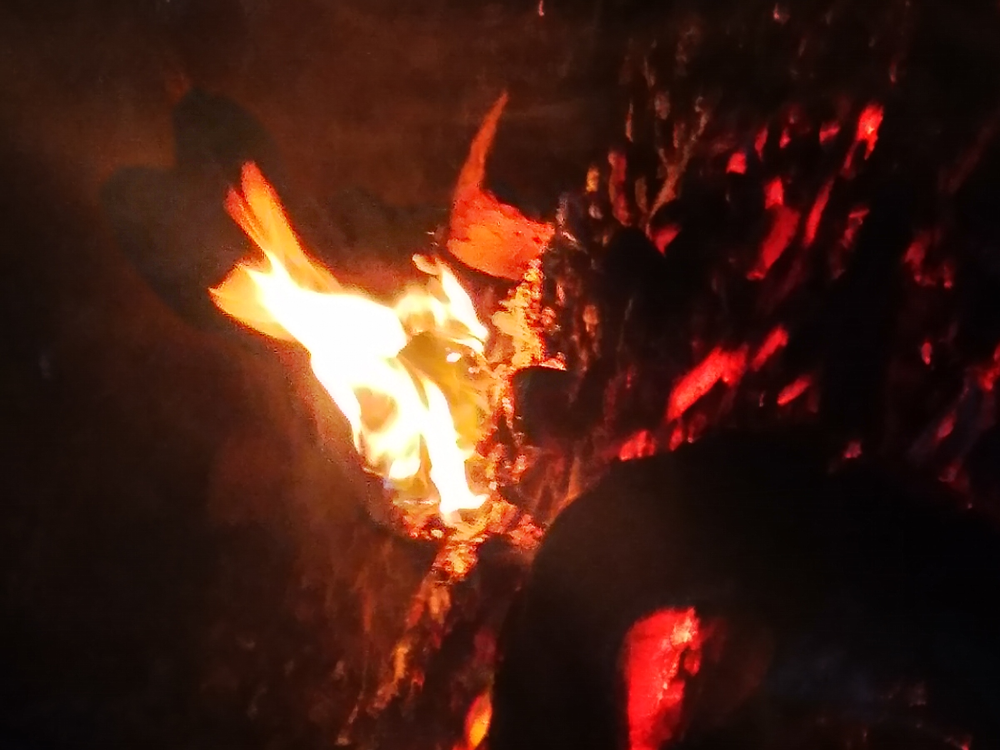

In [207]:
img_metadata_files[57].img

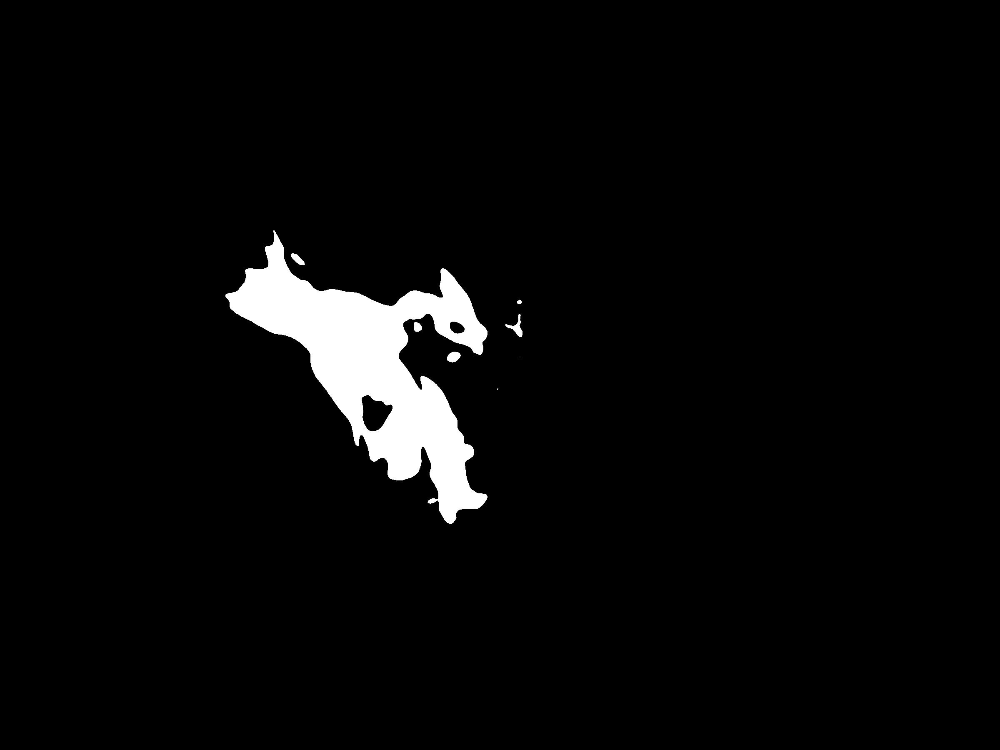

In [206]:
Image.open('.\\output_img\\filtered\\'+img_metadata_files[57].name)

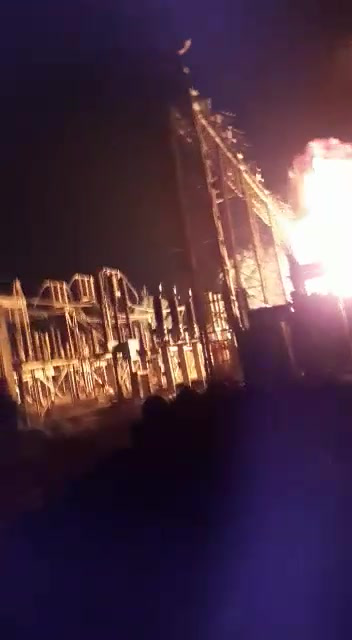

In [214]:
img_metadata_files[93].img

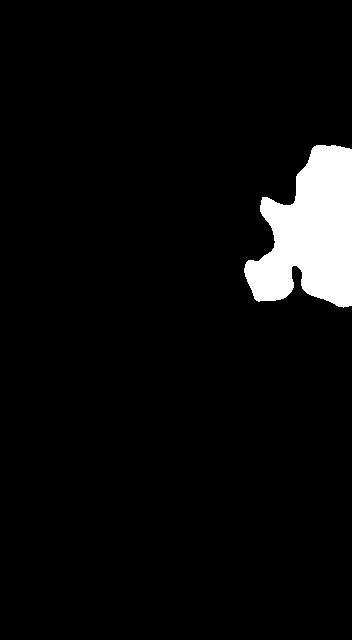

In [215]:
Image.open('.\\output_img\\filtered\\'+img_metadata_files[93].name)

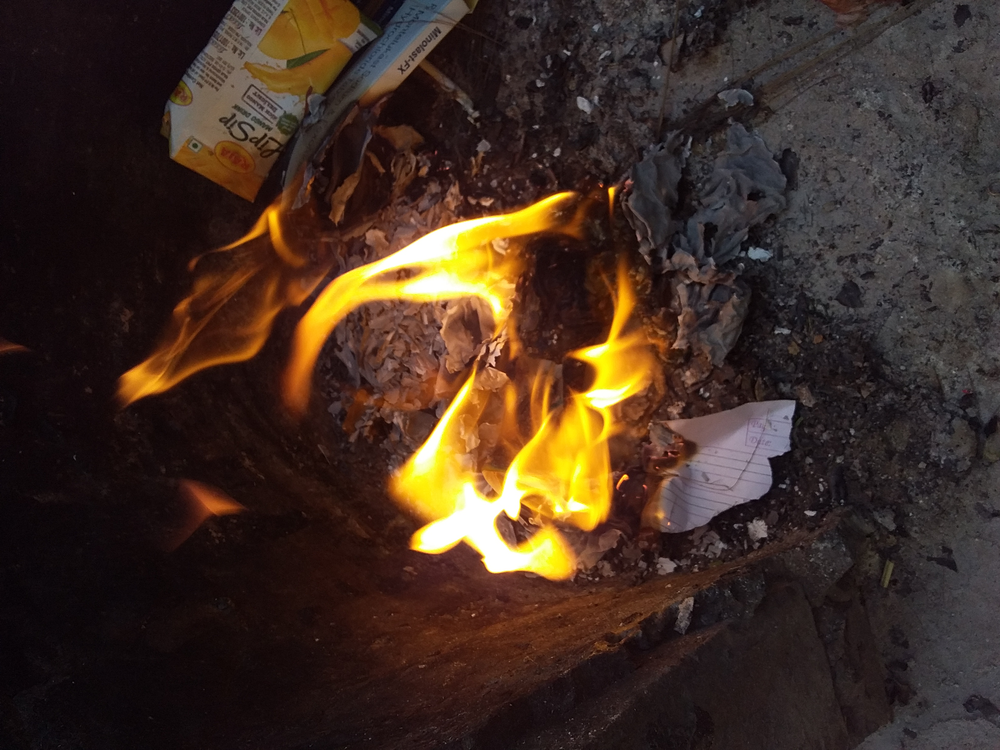

In [221]:
img_metadata_files[20].img

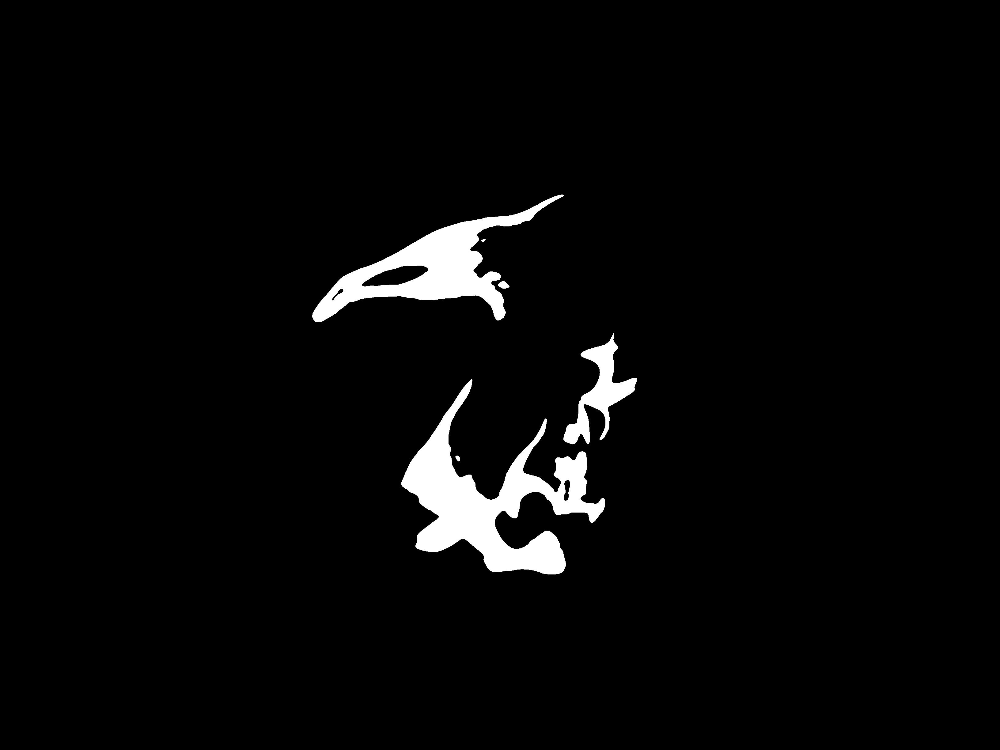

In [222]:
Image.open('.\\output_img\\filtered\\'+img_metadata_files[20].name)

*********

Ahora de igual manera existen resultados no deseados, y sobre todo es en las imágenes de día, o en las que existan partes con mucho brillo. Esto debido a la técnica utilizada, ya que se confunden estas zonas, con la luminosidad que emite el fuego.

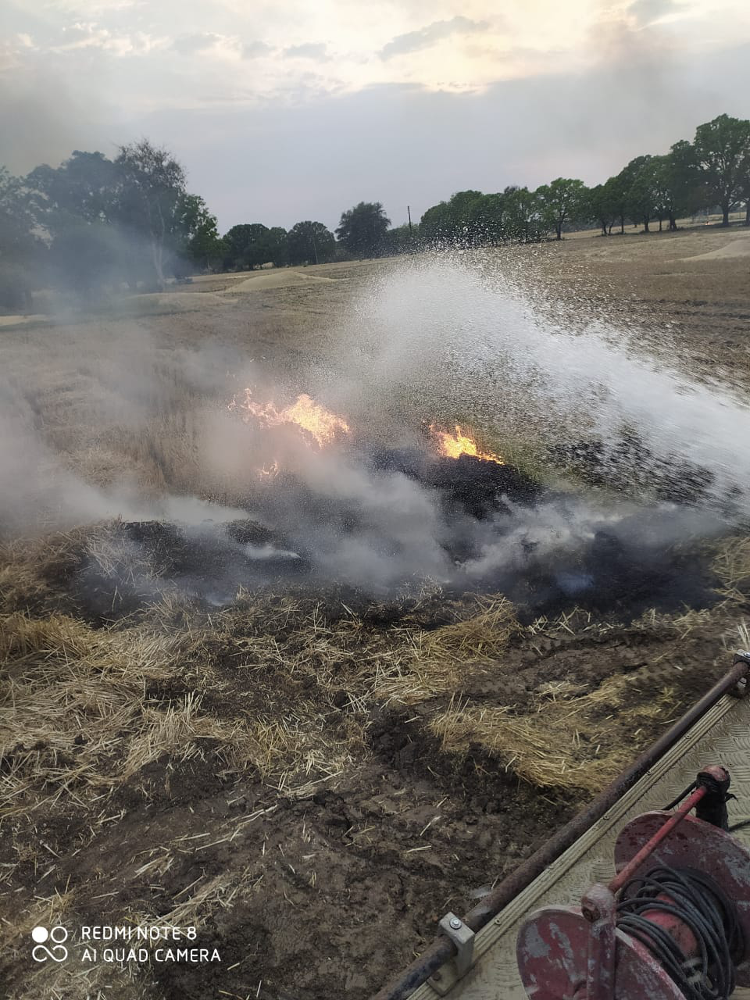

In [224]:
img_metadata_files[69].img

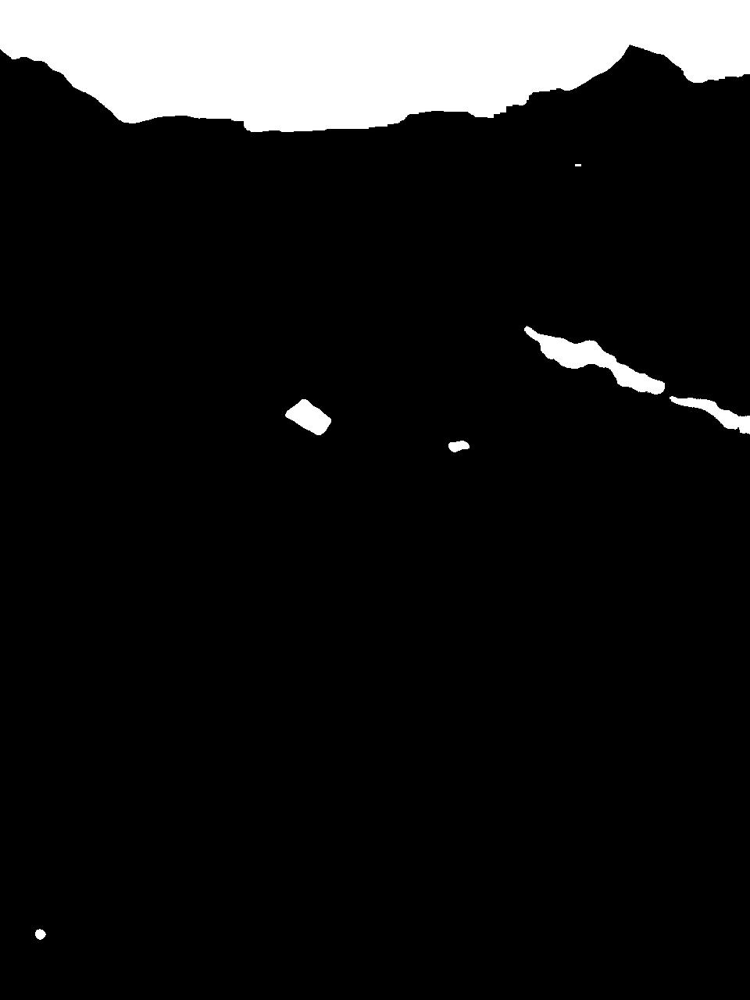

In [223]:
Image.open('.\\output_img\\filtered\\'+img_metadata_files[69].name)

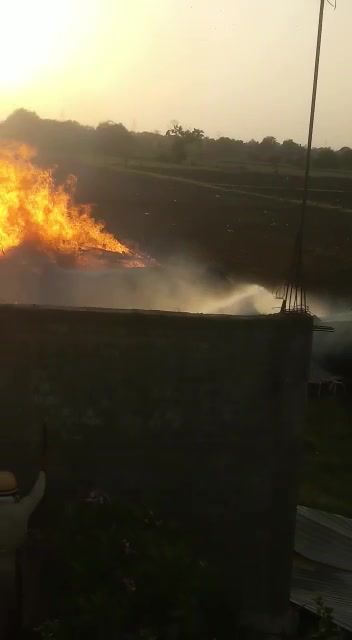

In [225]:
img_metadata_files[90].img

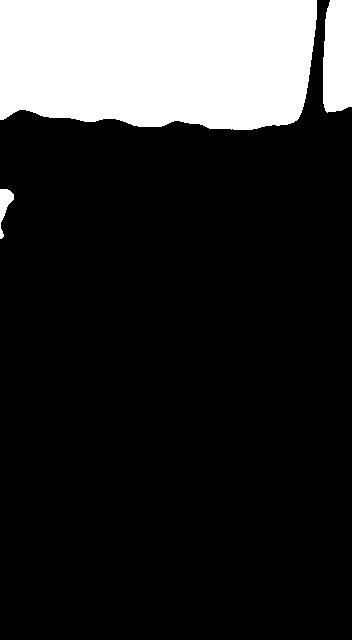

In [226]:
Image.open('.\\output_img\\filtered\\'+img_metadata_files[90].name)

*************

### Conclusión

Se debe buscar una segunda solución para las imágenes de día, quizás intentar identificar los pixeles por rango de color entre narango y amarillos para que no se confunda el fuego con el cielo, si se quiere seguir con soluciones mediante el manejo de la imagen en sí, o pasar a un entrenamiento de clasificación utilizando técnicas de "deep learning". Lo que podría ser un factor a considerar no uniformidad del fuego, ya que esta varía según los factores externos a él.

Nota: Repositorio github con imagenes input y output del proceso. <br />
Link: https://github.com/pssotosa/MDS/tree/Vision_Computacional